# Prepare environment
Load Python packages:

In [1]:
import warnings

warnings.filterwarnings("ignore")

import matplotlib.pyplot as plt
import seaborn as sns
import scanpy as sc
import pandas as pd
import numpy as np
import random
import itertools

from sklearn.preprocessing import StandardScaler
from sklearn.cluster import AgglomerativeClustering

from tqdm import tqdm

import decoupler as dc
import sys

sys.path.append("./../../../utilities_folder/")
from utilities import save_object, load_object, intTable, plotGenesInTerm, run_ora_catchErrors, getAnnGenes, filter_by_expr

Set R environment with rpy2:

In [2]:
import rpy2.rinterface_lib.callbacks
import anndata2ri
import logging

from rpy2.robjects import pandas2ri
import rpy2.robjects as ro
from scipy import stats

sc.settings.verbosity = 0
rpy2.rinterface_lib.callbacks.logger.setLevel(logging.ERROR)

pandas2ri.activate()
anndata2ri.activate()

%load_ext rpy2.ipython

Set up parameters for Python plots:

In [3]:
%matplotlib inline
sc.set_figure_params(dpi = 180, fontsize = 20)

plt.rcParams['pdf.fonttype'] = 'truetype'

color_palette = {
    'iMeLC': '#377eb8',
    'hEGCLC': '#ff7f00',
    'hPGCLC': '#4daf4a',
    'hiPSC': '#dd1c77',
    'HEP': '#a65628',
    'MLC': '#f781bf',
    'EndLC': '#999999',
     'AmLC': '#80b1d3',
}

Import R libraries:

In [4]:
%%R
source('./../../../utilities_folder/GO_helper.r')
loc <- './../../../R_loc' # pointing to the renv environment

.libPaths(loc)

library('topGO')
library('edgeR')
library('org.Hs.eg.db')
library(dplyr)
library(ggplot2)

edg2 <- function(e,mm,gt){
  row.names(mm) <- colnames(e)
  dds <- calcNormFactors(DGEList(e))
  dds <- estimateGLMRobustDisp(dds,mm)
  dds <- glmFit(dds, mm)
  res <- topTags(glmQLFTest(dds, gt), nrow(e))
  res
}

Import some R functions directly in Python:

In [5]:
edgeR_topTags = ro.r['topTags']
edgeR_glmLRT = ro.r['glmLRT']
edgeR_glmQLFTest = ro.r['glmQLFTest']
as_data_frame = ro.r['as.data.frame']
rprint = rpy2.robjects.globalenv.find("print")

Set up some parameters for R plots:

In [6]:
#| echo: false

default_units = 'in' 
default_res = 300 
default_width = 10
default_height = 9

import rpy2
old_setup_graphics = rpy2.ipython.rmagic.RMagics.setup_graphics

def new_setup_graphics(self, args):
    if getattr(args, 'units') is not None:
        if args.units != default_units: # a different units argument was passed, do not apply defaults
            return old_setup_graphics(self, args)
    args.units = default_units
    if getattr(args, 'res') is None:
        args.res = default_res
    if getattr(args, 'width') is None:
        args.width = default_width
    if getattr(args, 'height') is None:
        args.height = default_height        
    return old_setup_graphics(self, args)

rpy2.ipython.rmagic.RMagics.setup_graphics = new_setup_graphics

## Set up folders

In [7]:
tables_folder = './tables/'

# Load data

In [8]:
adata = sc.read("./../01_Annotation/2_All_WithCellCycle.h5ad")
adata

AnnData object with n_obs × n_vars = 27925 × 14582
    obs: 'sample_id', 'run_id', 'probe_barcode_ids', 'subject', 'line', 'specimen', 'stage', 'condition', 'notes', 'seqRun', 'original_name', 'project', 'who', 'SC_derivation', 'micoplasma', 'mosaic', 'genSite', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mito', 'log1p_total_counts_mito', 'pct_counts_mito', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'gene_UMI_ratio', 'log1p_gene_UMI_ratio', 'scDblFinder_score', 'scDblFinder_class', 'n_counts', 'n_genes', 'leiden', 'score_pluripotency', 'score_mesoderm', 'score_PS', 'score_EM', 'score_AM', 'score_Endo', 'score_Epi', 'score_HEP', 'score_NM', 'score_ExM', 'score_Ery', 'score_EAE', 'score_Amnion_LC', 'score_AxM', 'score_Amnion', 'score_NNE', 'score_PGC', 'score_hPGCLCs', 'score_DE1', 'score_DE2', 'score_Hypoblast', 'score_YS', 'score_EMPs', 'score_Endothelium', 'score_Myeloid_Progenitors', 'score_Megakaryocyte_

In [9]:
# Get pseudo-bulk profile
adata_sub = adata[adata.obs.CellTypes.isin(['hEGCLC', 'hPGCLC', 'iMeLC', 'hiPSC'])].copy()
sc.pp.calculate_qc_metrics(adata_sub, inplace = True)

In [10]:
adata_sub

AnnData object with n_obs × n_vars = 19638 × 14582
    obs: 'sample_id', 'run_id', 'probe_barcode_ids', 'subject', 'line', 'specimen', 'stage', 'condition', 'notes', 'seqRun', 'original_name', 'project', 'who', 'SC_derivation', 'micoplasma', 'mosaic', 'genSite', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mito', 'log1p_total_counts_mito', 'pct_counts_mito', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'gene_UMI_ratio', 'log1p_gene_UMI_ratio', 'scDblFinder_score', 'scDblFinder_class', 'n_counts', 'n_genes', 'leiden', 'score_pluripotency', 'score_mesoderm', 'score_PS', 'score_EM', 'score_AM', 'score_Endo', 'score_Epi', 'score_HEP', 'score_NM', 'score_ExM', 'score_Ery', 'score_EAE', 'score_Amnion_LC', 'score_AxM', 'score_Amnion', 'score_NNE', 'score_PGC', 'score_hPGCLCs', 'score_DE1', 'score_DE2', 'score_Hypoblast', 'score_YS', 'score_EMPs', 'score_Endothelium', 'score_Myeloid_Progenitors', 'score_Megakaryocyte_

In [11]:
sc.pp.filter_genes(adata_sub, min_cells = 100)

In [12]:
adata_sub

AnnData object with n_obs × n_vars = 19638 × 14221
    obs: 'sample_id', 'run_id', 'probe_barcode_ids', 'subject', 'line', 'specimen', 'stage', 'condition', 'notes', 'seqRun', 'original_name', 'project', 'who', 'SC_derivation', 'micoplasma', 'mosaic', 'genSite', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mito', 'log1p_total_counts_mito', 'pct_counts_mito', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'gene_UMI_ratio', 'log1p_gene_UMI_ratio', 'scDblFinder_score', 'scDblFinder_class', 'n_counts', 'n_genes', 'leiden', 'score_pluripotency', 'score_mesoderm', 'score_PS', 'score_EM', 'score_AM', 'score_Endo', 'score_Epi', 'score_HEP', 'score_NM', 'score_ExM', 'score_Ery', 'score_EAE', 'score_Amnion_LC', 'score_AxM', 'score_Amnion', 'score_NNE', 'score_PGC', 'score_hPGCLCs', 'score_DE1', 'score_DE2', 'score_Hypoblast', 'score_YS', 'score_EMPs', 'score_Endothelium', 'score_Myeloid_Progenitors', 'score_Megakaryocyte_

In [13]:
adata_bulk = dc.get_pseudobulk(adata_sub, sample_col='sample_id', groups_col='CellTypes', layer = 'raw', min_prop=0.1, min_smpls = 1)
adata_bulk.layers['raw'] = adata_bulk.X.copy()
adata_bulk

AnnData object with n_obs × n_vars = 9 × 12175
    obs: 'sample_id', 'run_id', 'probe_barcode_ids', 'subject', 'line', 'specimen', 'stage', 'condition', 'notes', 'seqRun', 'original_name', 'project', 'who', 'SC_derivation', 'micoplasma', 'mosaic', 'genSite', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'scDblFinder_class', 'CellTypes'
    layers: 'raw'

In [14]:
adata_bulk

AnnData object with n_obs × n_vars = 9 × 12175
    obs: 'sample_id', 'run_id', 'probe_barcode_ids', 'subject', 'line', 'specimen', 'stage', 'condition', 'notes', 'seqRun', 'original_name', 'project', 'who', 'SC_derivation', 'micoplasma', 'mosaic', 'genSite', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'scDblFinder_class', 'CellTypes'
    layers: 'raw'

In [15]:
genes_to_keep = filter_by_expr(adata_bulk, group = 'CellTypes', min_count = 10, min_total_count = 200, min_prop = 0)
adata_bulk = adata_bulk[:, genes_to_keep]
adata_bulk

View of AnnData object with n_obs × n_vars = 9 × 12003
    obs: 'sample_id', 'run_id', 'probe_barcode_ids', 'subject', 'line', 'specimen', 'stage', 'condition', 'notes', 'seqRun', 'original_name', 'project', 'who', 'SC_derivation', 'micoplasma', 'mosaic', 'genSite', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'scDblFinder_class', 'CellTypes'
    layers: 'raw'

In [16]:
pd.Series(genes_to_keep).to_csv('./tables/all_bkg_genes.csv')

In [17]:
adata_bulk.layers['raw'][0]

ArrayView([ 1347.,  5013.,  5741., ...,  2746., 22777.,  1280.],
          dtype=float32)

# Gene expression patterns in iPSCs -> iMeLC -> hPGCLC -> hEGCLC 
K-means method

In [18]:
adata_bulk_sub = adata_bulk[adata_bulk.obs.CellTypes.isin(['hEGCLC', 'hPGCLC', 'iMeLC', 'hiPSC'])]
sc.pp.normalize_total(adata_bulk_sub, target_sum = 1e6)
sc.pp.log1p(adata_bulk_sub)

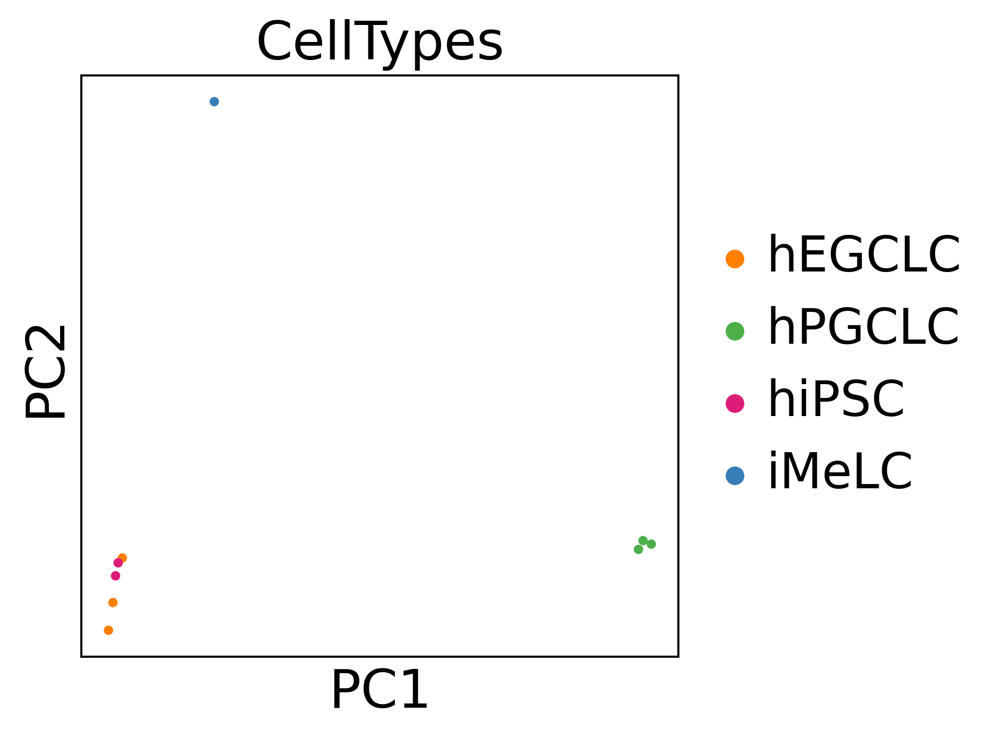

In [19]:
sc.tl.pca(adata_bulk_sub)
sc.pl.pca(adata_bulk_sub, color = 'CellTypes', palette=color_palette, s = 50)


In [20]:
total = pd.DataFrame(adata_bulk_sub.layers['raw'])
total.index = adata_bulk_sub.obs_names
total.columns = adata_bulk_sub.var_names
total = total.T

In [21]:
obs = adata_bulk_sub.obs
obs = obs[['sample_id', 'run_id', 'CellTypes']]
obs = obs.astype('str')
obs

,sample_id,run_id,CellTypes
EG2_hEGCLC,EG2,G01/,hEGCLC
EG31_hEGCLC,EG31,G01/,hEGCLC
EG9_hEGCLC,EG9,G01/,hEGCLC
2EB_hPGCLC,2EB,H01_WA/,hPGCLC
3EB_hPGCLC,3EB,H01_WA/,hPGCLC
5EB_hPGCLC,5EB,G01/,hPGCLC
IEO_13_A_R_hiPSC,IEO_13_A_R,G01/,hiPSC
ht15_FIX_hiPSC,ht15_FIX,A01/,hiPSC
5IM_iMeLC,5IM,G01/,iMeLC


In [22]:
total

,EG2_hEGCLC,EG31_hEGCLC,EG9_hEGCLC,2EB_hPGCLC,3EB_hPGCLC,5EB_hPGCLC,IEO_13_A_R_hiPSC,ht15_FIX_hiPSC,5IM_iMeLC
A4GALT,1347.0,1298.0,1009.0,2367.0,442.0,262.0,991.0,1108.0,1164.0
AAAS,5013.0,4689.0,5185.0,1529.0,329.0,163.0,7215.0,9254.0,6099.0
AACS,5741.0,4033.0,6260.0,3930.0,920.0,421.0,5337.0,5726.0,5708.0
AADAT,772.0,563.0,847.0,1065.0,231.0,95.0,767.0,1127.0,2866.0
AAGAB,6122.0,4680.0,6805.0,1976.0,413.0,190.0,5934.0,7537.0,7515.0
...,...,...,...,...,...,...,...,...,...
ZXDC,2341.0,2347.0,2445.0,982.0,173.0,68.0,2548.0,3444.0,3264.0
ZYG11A,0.0,0.0,0.0,2122.0,493.0,233.0,517.0,754.0,1147.0
ZYG11B,2746.0,2526.0,3095.0,1741.0,356.0,131.0,2903.0,4624.0,3641.0
ZYX,22777.0,16653.0,27183.0,8560.0,1322.0,659.0,12780.0,17644.0,22507.0


In [23]:
celltypes = total.columns.map(lambda x: x.split('_')[-1])
celltypes

Index(['hEGCLC', 'hEGCLC', 'hEGCLC', 'hPGCLC', 'hPGCLC', 'hPGCLC', 'hiPSC',
       'hiPSC', 'iMeLC'],
      dtype='object')

In [24]:
%%R -i celltypes -i total

celltypes_leveled <- relevel(as.factor(celltypes), ref="hiPSC")
mm <- model.matrix(~ celltypes_leveled, data = total)
mm

      [,1] [,2] [,3] [,4]
 [1,]    1    1    0    0
 [2,]    1    1    0    0
 [3,]    1    1    0    0
 [4,]    1    0    1    0
 [5,]    1    0    1    0
 [6,]    1    0    1    0
 [7,]    1    0    0    0
 [8,]    1    0    0    0
 [9,]    1    0    0    1


In [25]:
%%R
print(celltypes_leveled)

[1] hEGCLC hEGCLC hEGCLC hPGCLC hPGCLC hPGCLC hiPSC  hiPSC  iMeLC 
Levels: hiPSC hEGCLC hPGCLC iMeLC


In [26]:
%%R -o res

row.names(mm) <- colnames(total)
dds <- calcNormFactors(DGEList(total))
dds <- estimateDisp(dds,mm)
dds <- glmQLFit(dds, mm)
res <- as.data.frame(topTags(glmLRT(dds, coef = 2:4), nrow(total)))

## Get results

In [27]:
res[res.FDR < 0.01]

,logFC.celltypes_leveledhEGCLC,logFC.celltypes_leveledhPGCLC,logFC.celltypes_levelediMeLC,logCPM,LR,PValue,FDR
AHNAK,12.038674,16.815994,12.683582,6.820741,2711.850761,0.000000,0.000000
TCL1A,11.389884,17.660164,0.000000,7.639515,3914.736661,0.000000,0.000000
ARID5B,11.235232,15.714693,0.000000,5.605302,2032.295508,0.000000,0.000000
DLL1,-11.228872,3.547954,-11.228872,4.575054,1533.970731,0.000000,0.000000
ALOX5,-11.178824,4.410238,-11.178824,5.439678,2245.284054,0.000000,0.000000
...,...,...,...,...,...,...,...
RNF168,0.244857,0.509361,0.248101,6.927043,12.117915,0.006990,0.009823
ZNF573,0.108464,0.658147,0.174038,4.617100,12.099088,0.007051,0.009908
ZDBF2,0.211985,-0.233416,-0.485272,5.353317,12.090716,0.007079,0.009946
MTX1,-0.429739,-0.443138,-0.580885,6.335249,12.089398,0.007083,0.009951


In [28]:
intTable(res, folder = './tables/', fileName = 'edgeR_results.xlsx', save = True)

Column
    [0] FileDownload(_transfers=1, auto=False, button_type='success', data='data:application/octet-st..., embed=True, file='./tables/edgeR_results.xl..., filename='edgeR_results.xlsx', label='Download edgeR_results.xl...)
    [1] Tabulator(page_size=10, pagination='remote', value=        logFC.celltypes_le...)

In [29]:
res_filt = res[res.FDR < 0.01]
len(res_filt)

8545

In [30]:
res_filt = res_filt[~res_filt.apply(lambda x: np.all(np.abs(x.iloc[0:3]) < 1), axis = 1)]

In [31]:
len(res_filt)

4997

In [32]:
intTable(res_filt, folder = './tables/', fileName = 'edgeR_results_filtered.xlsx', save = True)

Column
    [0] FileDownload(_transfers=1, auto=False, button_type='success', data='data:application/octet-st..., embed=True, file='./tables/edgeR_results_fi..., filename='edgeR_results_filtered.xl..., label='Download edgeR_results_fi...)
    [1] Tabulator(page_size=10, pagination='remote', value=         logFC.celltypes_l...)

In [33]:
x1 = res_filt.iloc[:,0].values.astype('float64')
x2 = res_filt.iloc[:,1].values.astype('float64')
x3 = res_filt.iloc[:,2].values.astype('float64')

In [34]:
X = np.array([x1, x2, x3]).T   
X = X.astype('float64')
X = StandardScaler().fit_transform(X)

In [35]:
x1 = X[:,0]
x2 = X[:,1]
x3 = X[:,2]

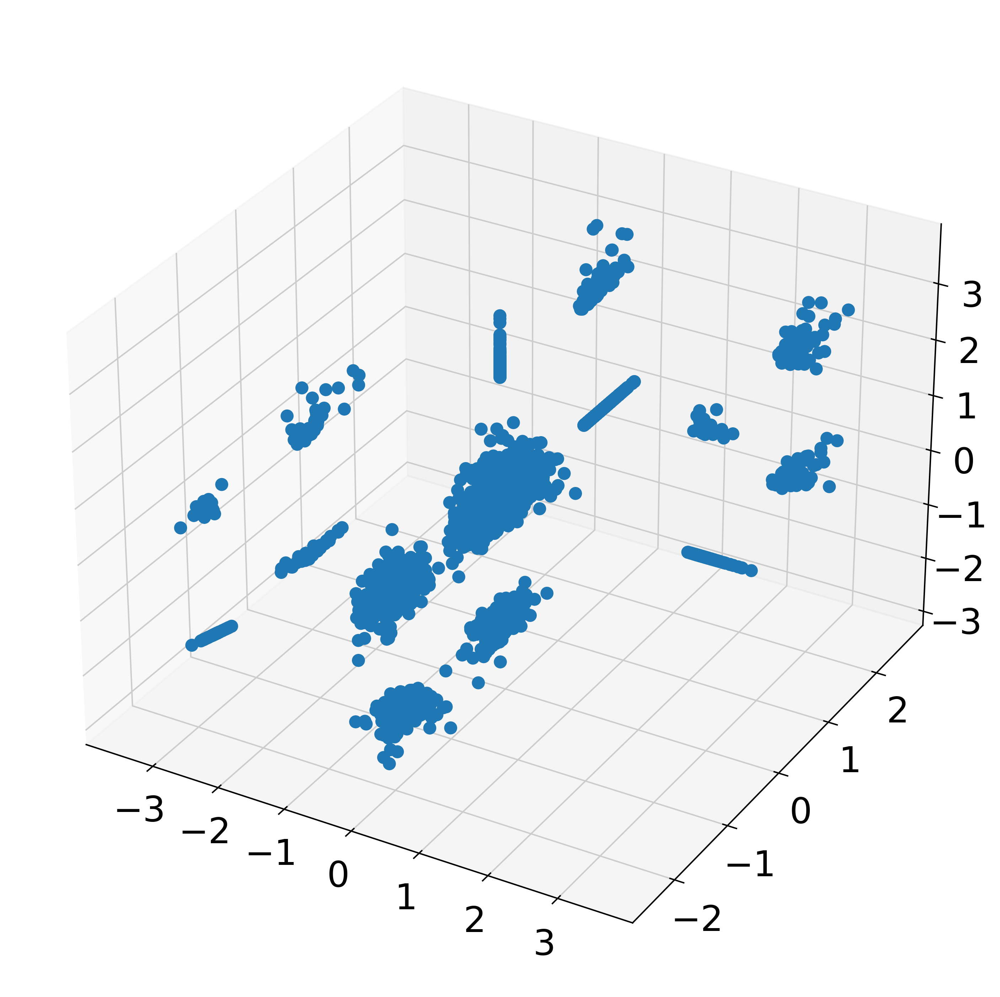

In [36]:
fig = plt.figure(figsize = (10,10))
ax = fig.add_subplot(111, projection = '3d')

ax.scatter(x1, x2, x3, s=40, marker='o', cmap='Spectral', alpha=1)

plt.show()

In [37]:
clusterer = AgglomerativeClustering(n_clusters = 15)
cluster_labels = clusterer.fit_predict(X)
res_filt['clusters'] = cluster_labels

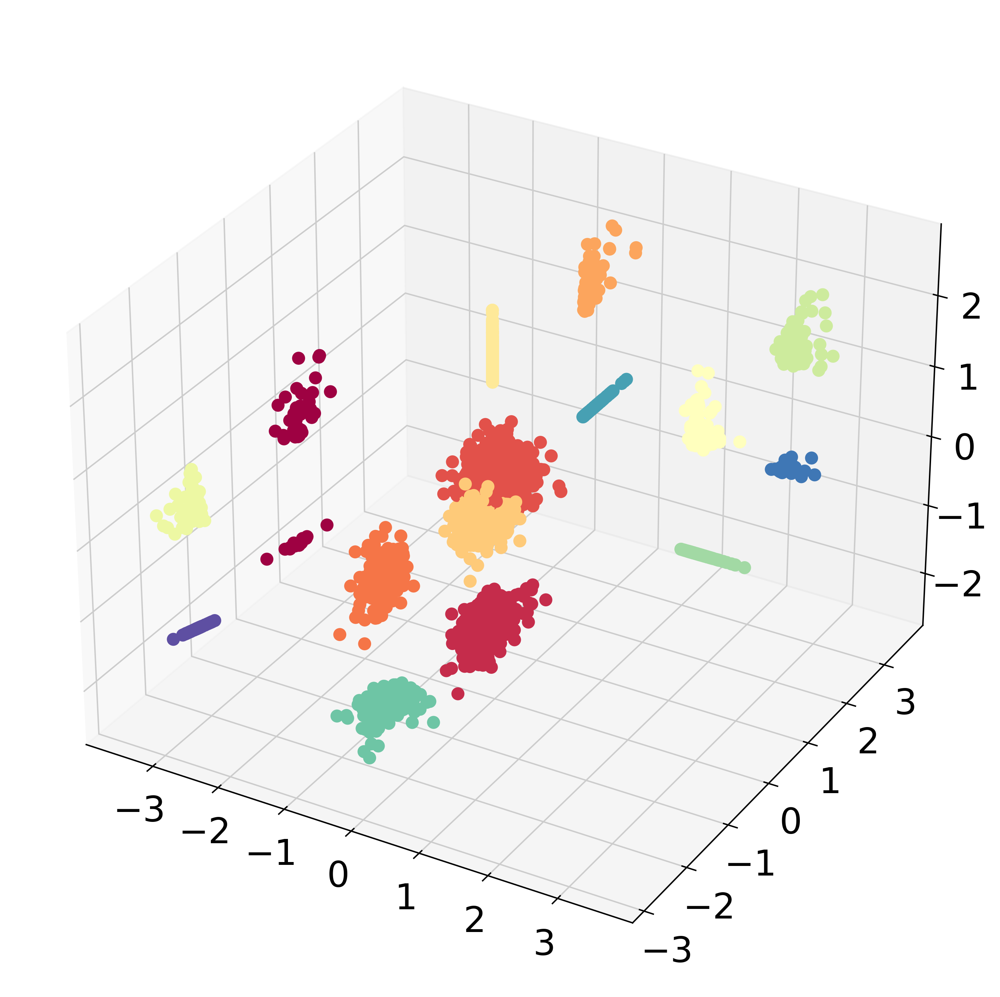

In [38]:
fig = plt.figure(figsize = (10,10))
ax = fig.add_subplot(111, projection = '3d')

ax.scatter(x1, x3, x2, s=40, c = res_filt.clusters, marker='o', cmap='Spectral', alpha=1)

plt.show()

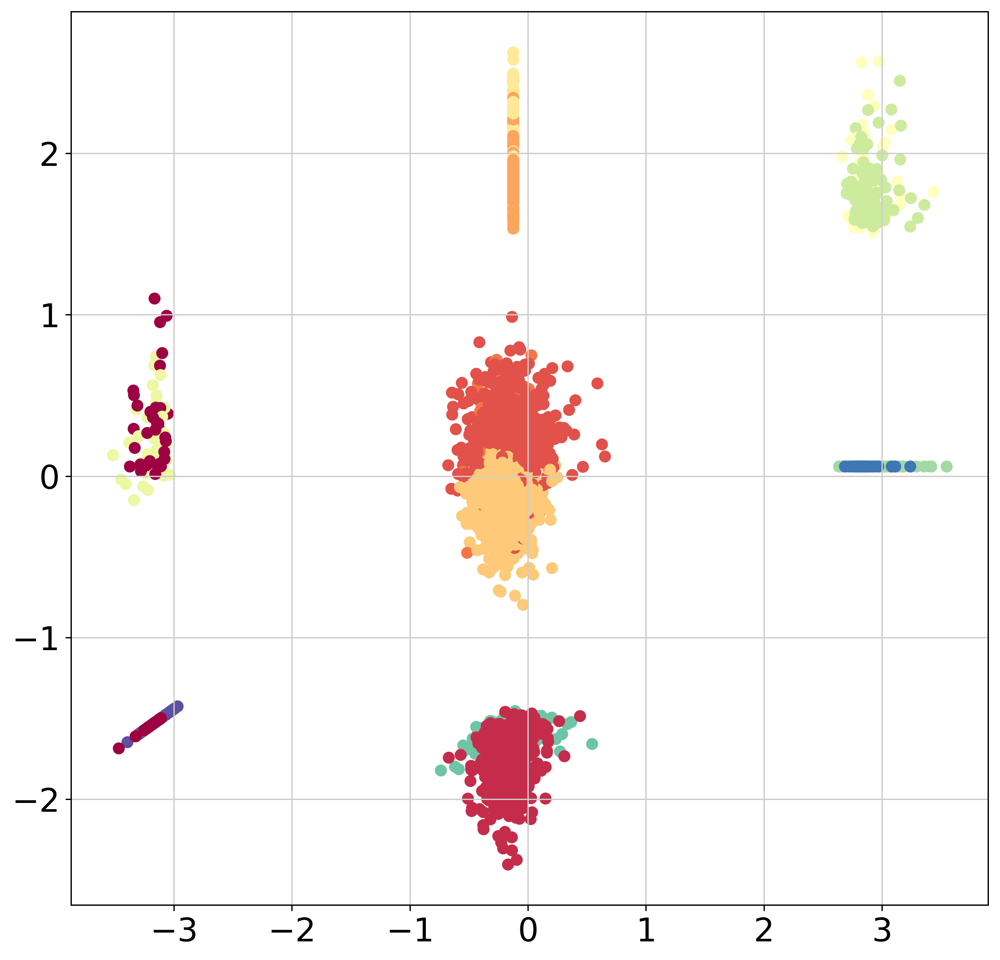

In [39]:
fig, ax = plt.subplots(figsize = (10,10))

ax.scatter(x1, x2, s=40, c = res_filt.clusters, marker='o', cmap='Spectral', alpha=1)

plt.show()

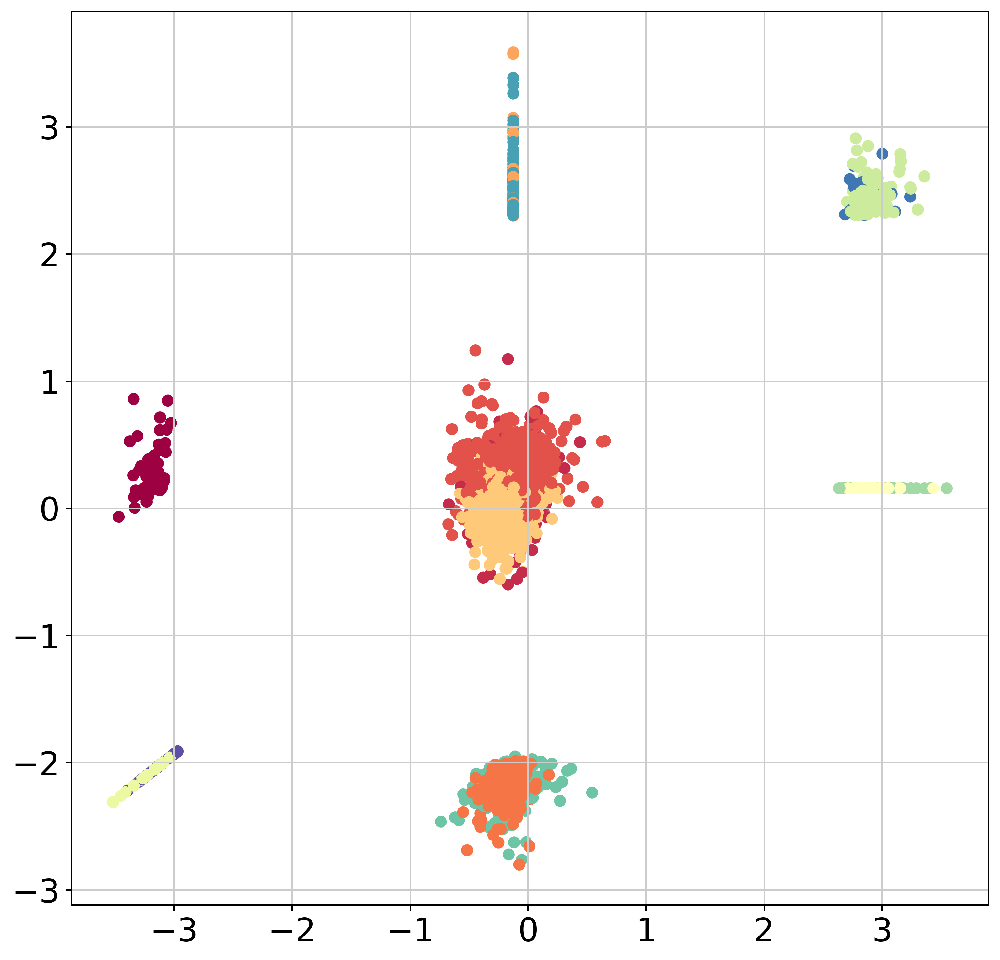

In [40]:
fig, ax = plt.subplots(figsize = (10,10))

ax.scatter(x1, x3, s=40, c = res_filt.clusters, marker='o', cmap='Spectral', alpha=1)

plt.show()

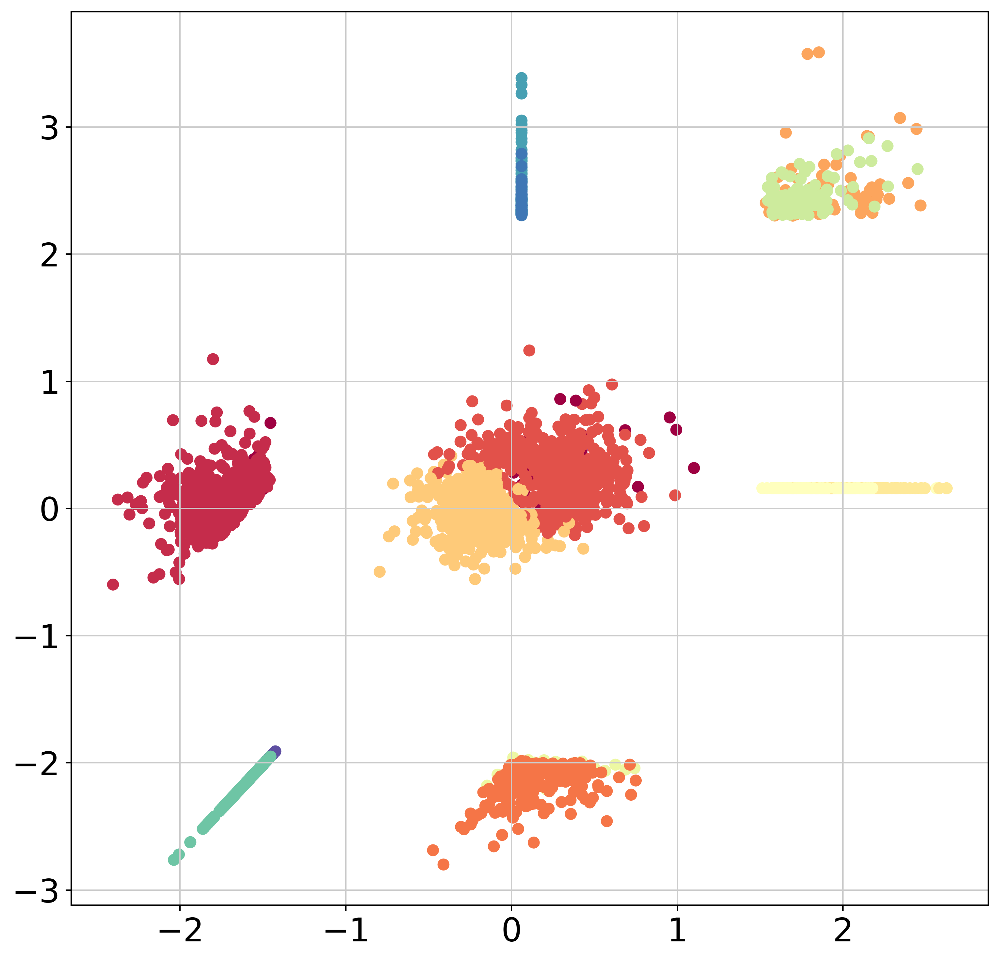

In [41]:
fig, ax = plt.subplots(figsize = (10,10))

ax.scatter(x2, x3, s=40, c = res_filt.clusters, marker='o', cmap='Spectral', alpha=1)

plt.show()

In [42]:
adata_bulk_sub.obs.CellTypes = adata_bulk_sub.obs.CellTypes.astype('category')
sub = adata_bulk_sub[adata_bulk_sub.obs.CellTypes.isin(['hiPSC', 'iMeLC', 'hPGCLC', 'hEGCLC'])].copy()
sc.pp.normalize_total(sub, target_sum = 1e6)
sc.pp.log1p(sub)
sub.obs.CellTypes = sub.obs.CellTypes.cat.remove_unused_categories()
sub.obs['CellTypes'] = sub.obs['CellTypes'].cat.reorder_categories(['hiPSC', 'iMeLC', 'hPGCLC', 'hEGCLC'])

## Heatmap for each cluster

Cluster: 9 ------- Number of genes in cluster:  106


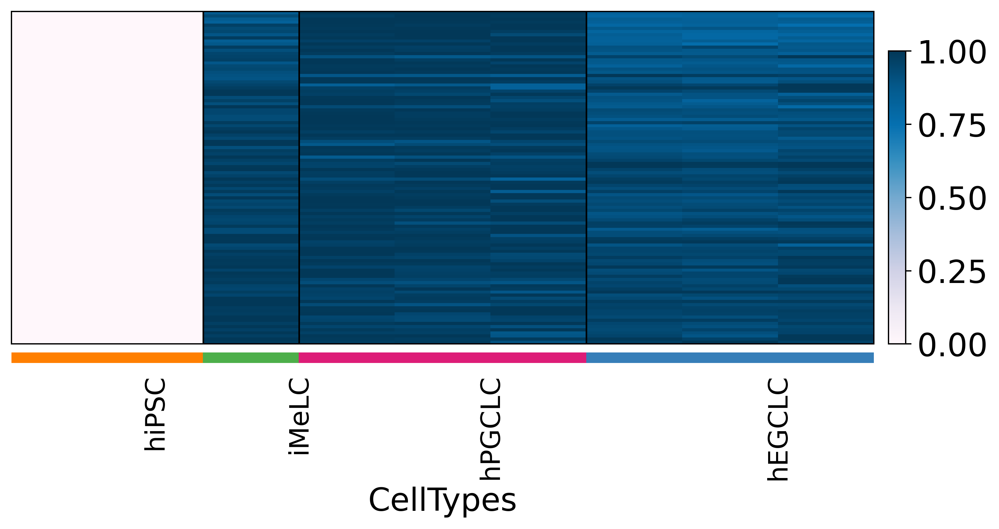

Cluster: 7 ------- Number of genes in cluster:  87


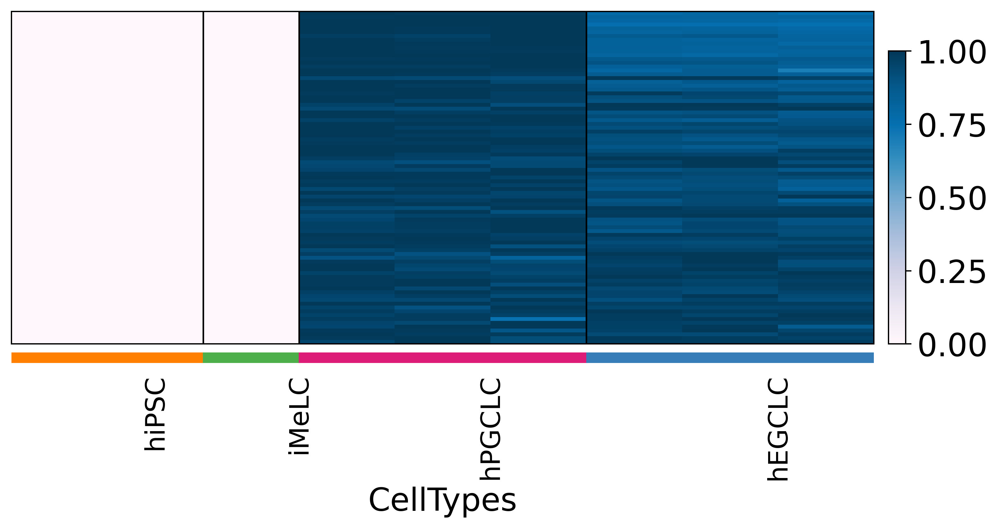

Cluster: 8 ------- Number of genes in cluster:  46


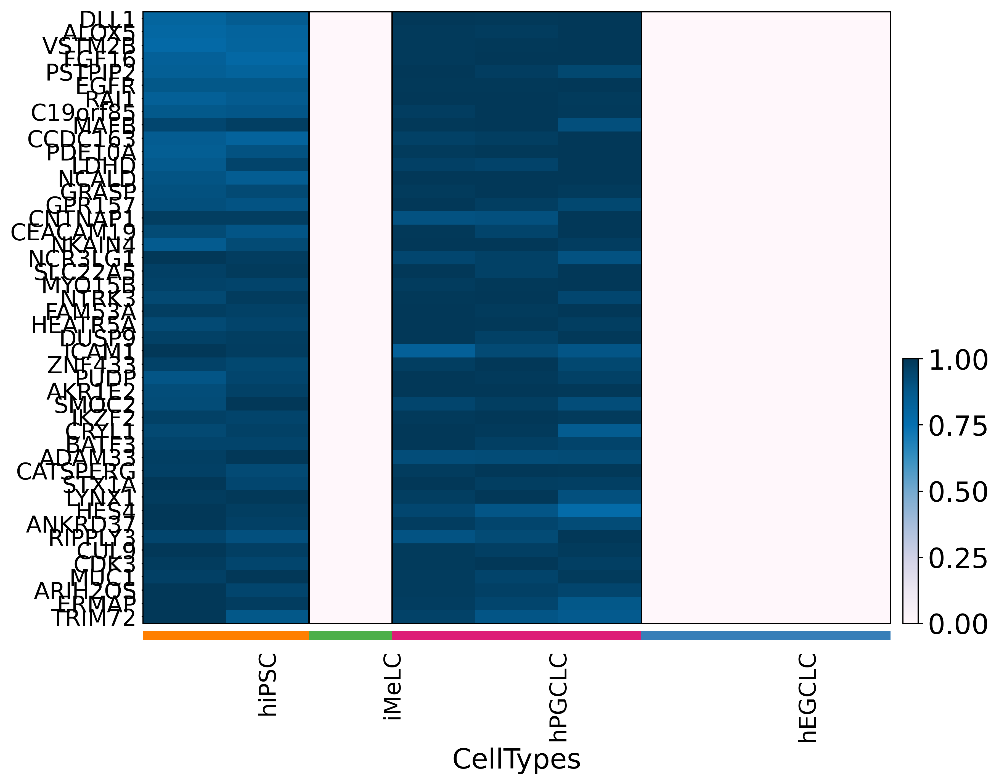

Cluster: 0 ------- Number of genes in cluster:  50


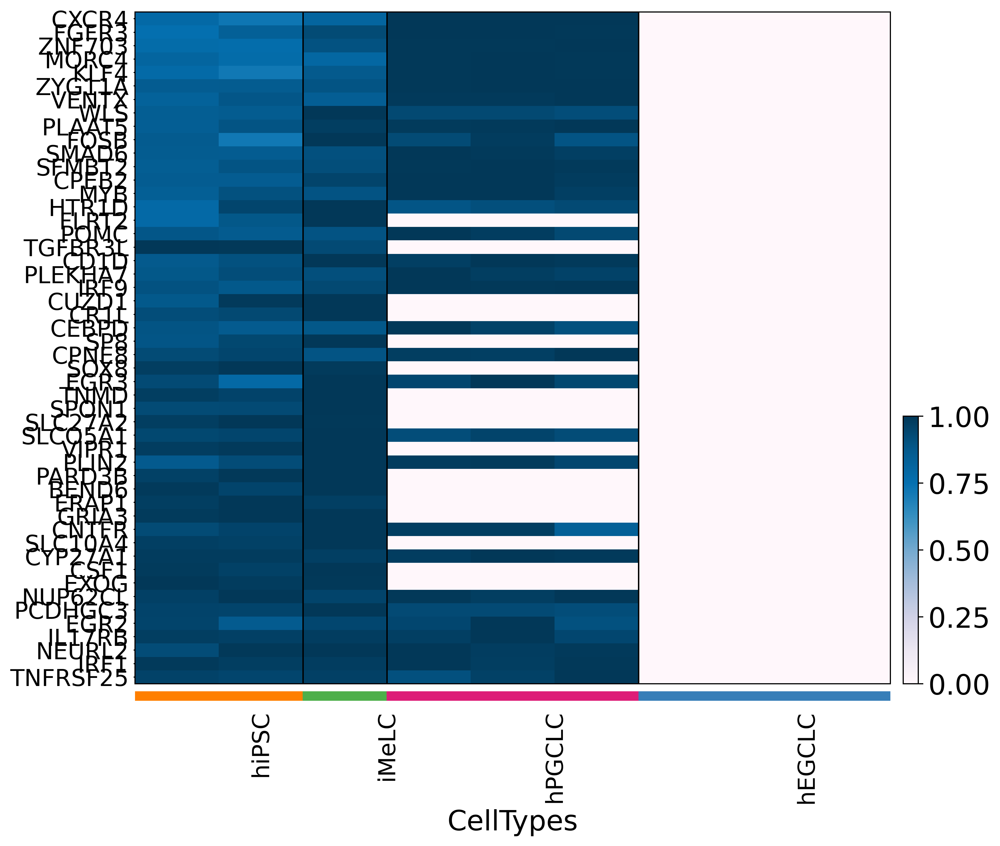

Cluster: 2 ------- Number of genes in cluster:  1499


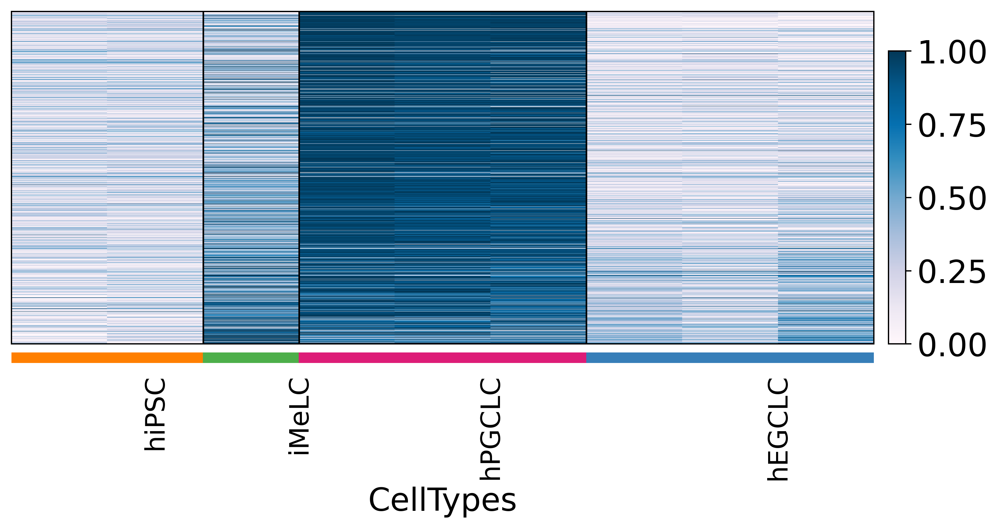

Cluster: 3 ------- Number of genes in cluster:  224


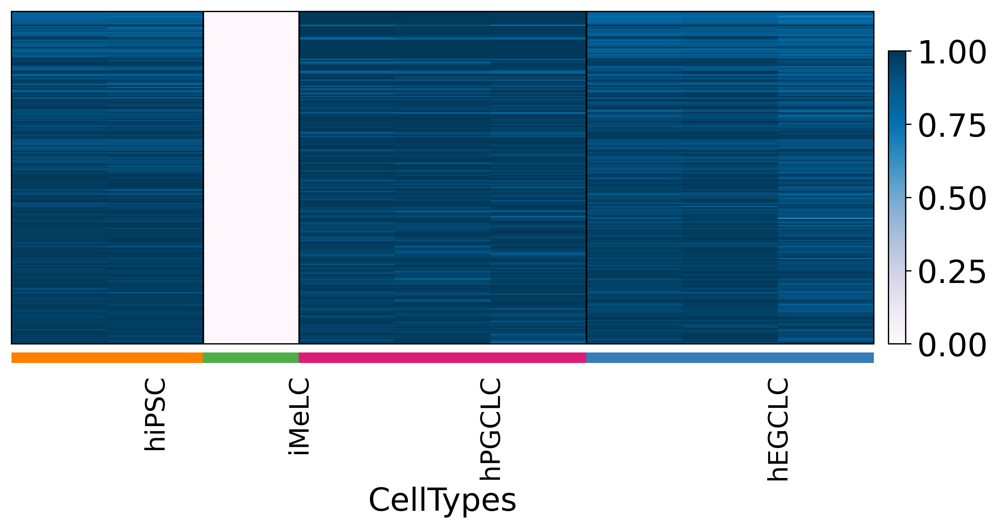

Cluster: 1 ------- Number of genes in cluster:  505


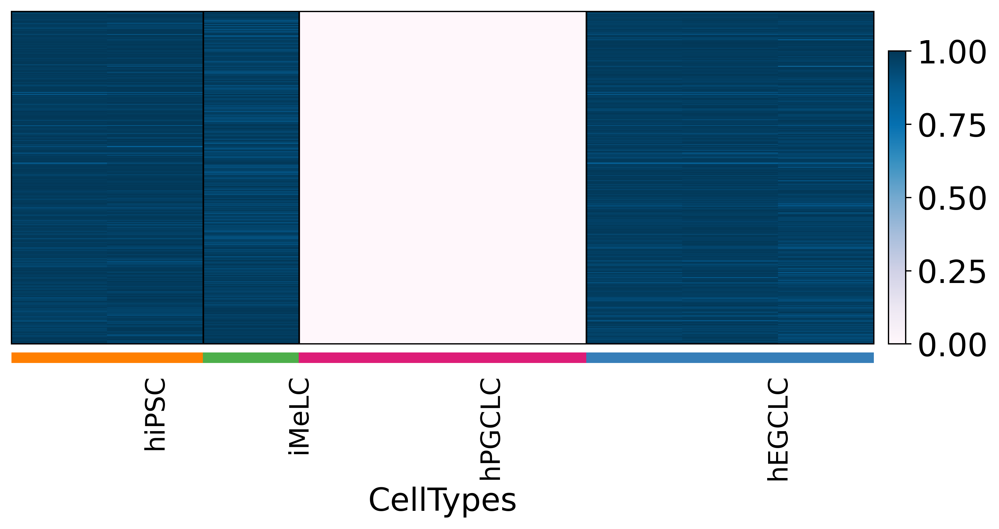

Cluster: 4 ------- Number of genes in cluster:  90


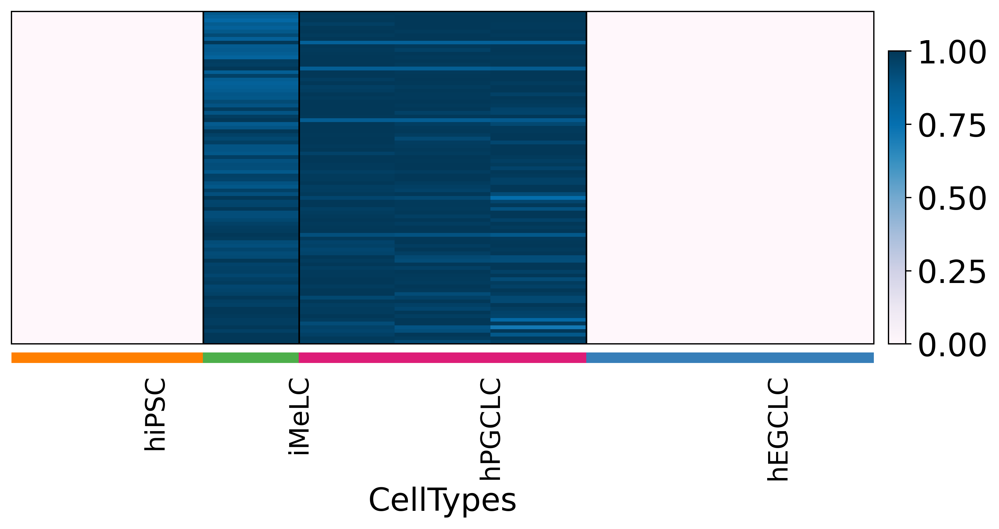

Cluster: 6 ------- Number of genes in cluster:  372


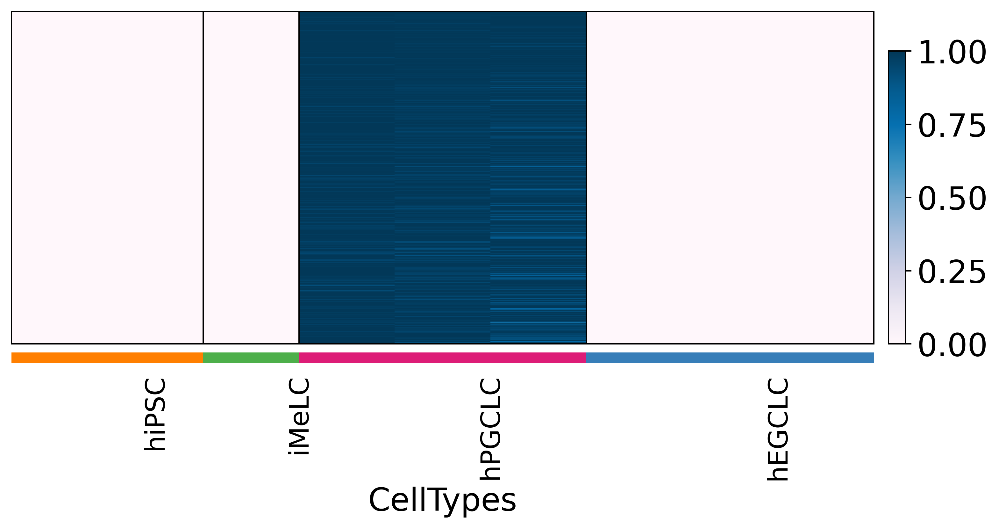

Cluster: 12 ------- Number of genes in cluster:  83


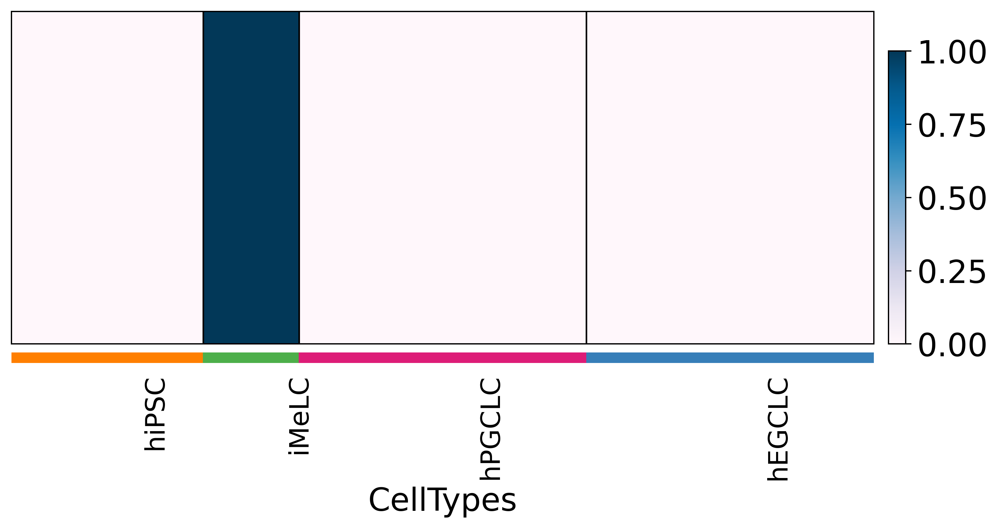

Cluster: 11 ------- Number of genes in cluster:  291


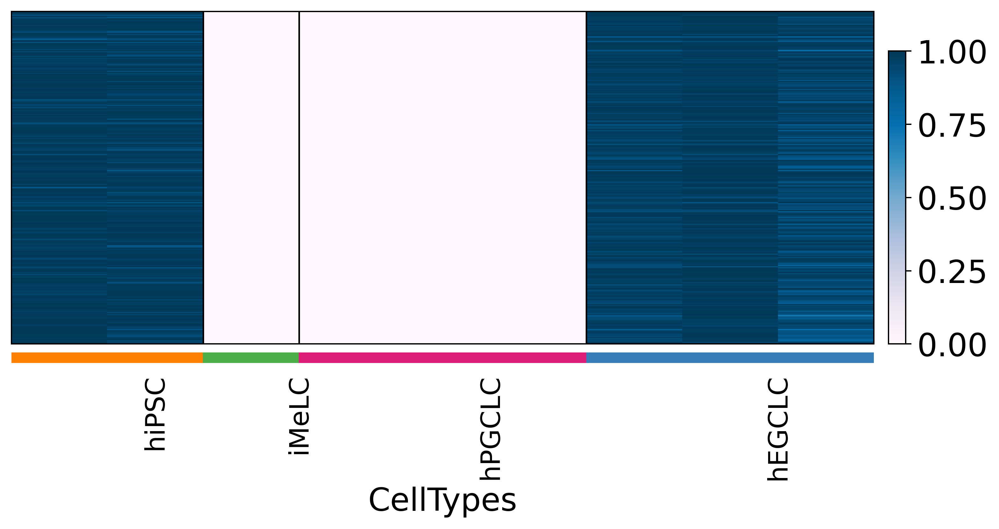

Cluster: 5 ------- Number of genes in cluster:  1384


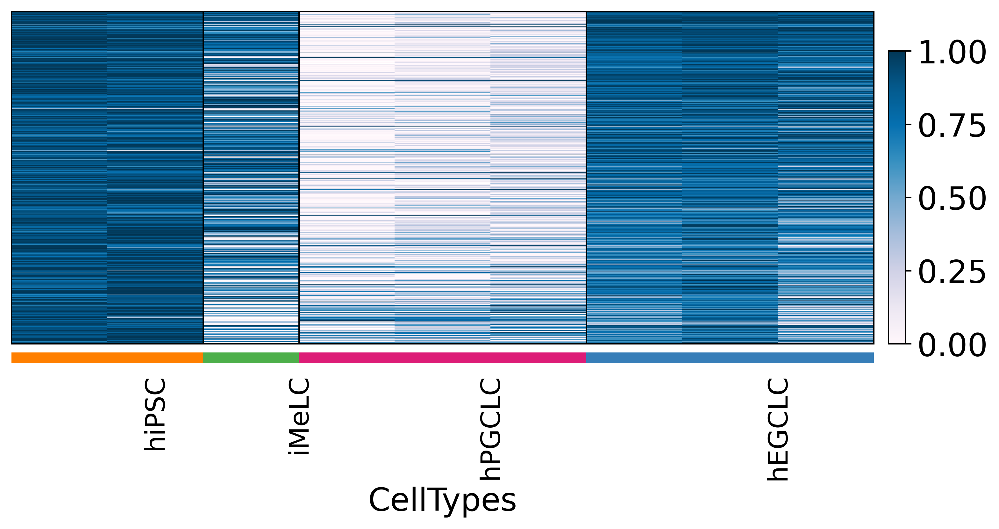

Cluster: 10 ------- Number of genes in cluster:  172


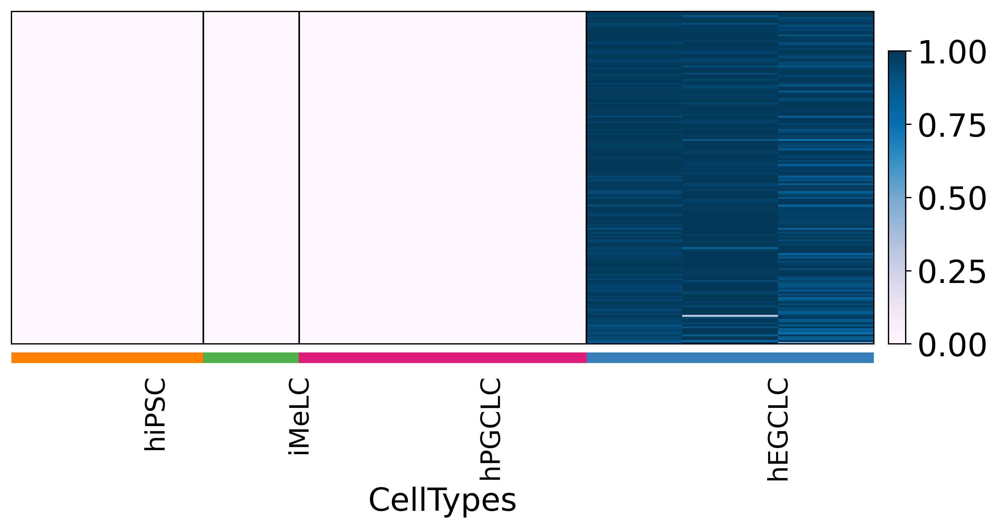

Cluster: 14 ------- Number of genes in cluster:  54


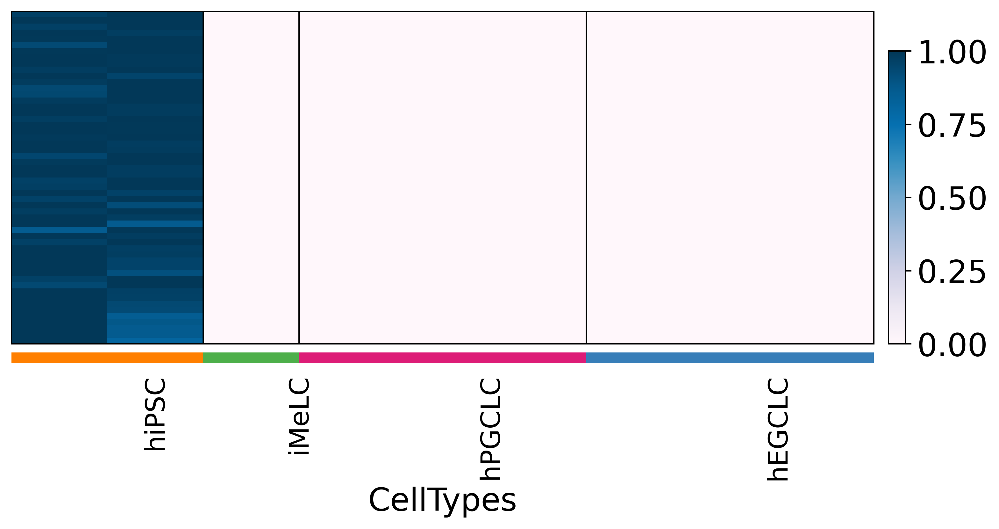

Cluster: 13 ------- Number of genes in cluster:  34


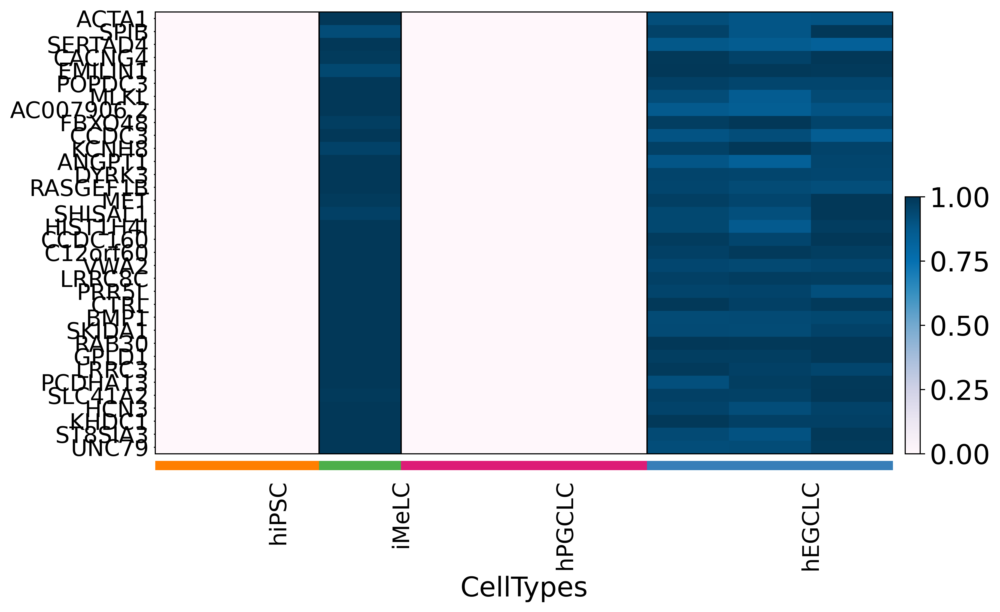

In [43]:
gene_clusters = {}
for i in res_filt.clusters.unique():
    gene_clusters[i] = res_filt[res_filt.clusters == i].index
    print("Cluster: " + str(i) + ' ------- Number of genes in cluster: ', len(gene_clusters[i]) )
    sc.pl.heatmap(sub, 
                  var_names = gene_clusters[i], 
              groupby = 'CellTypes', cmap = 'PuBu', swap_axes = True, 
               standard_scale='var',)
    #ax.title('Cluster: ' + str(i))
    plt.show()

Cluster: 9 ------- Number of genes in cluster:  106


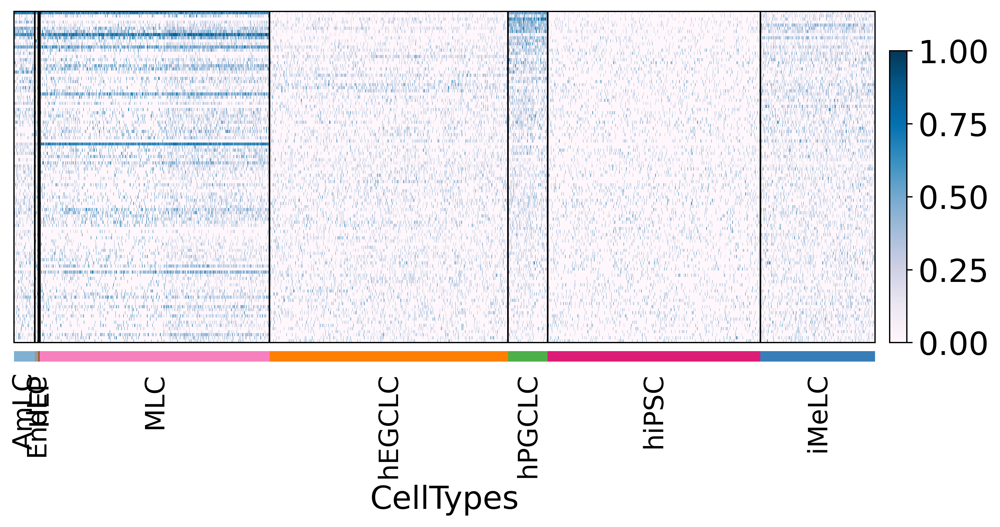

Cluster: 7 ------- Number of genes in cluster:  87


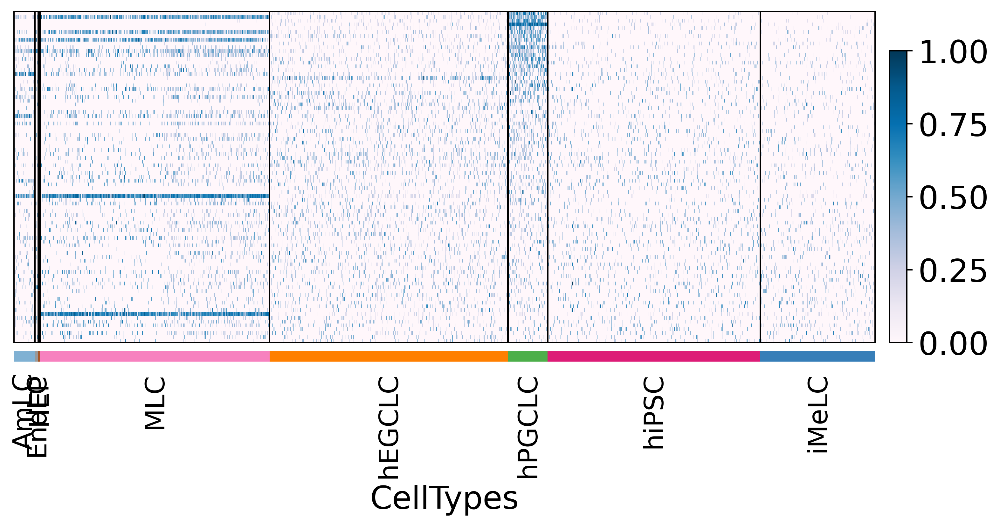

Cluster: 8 ------- Number of genes in cluster:  46


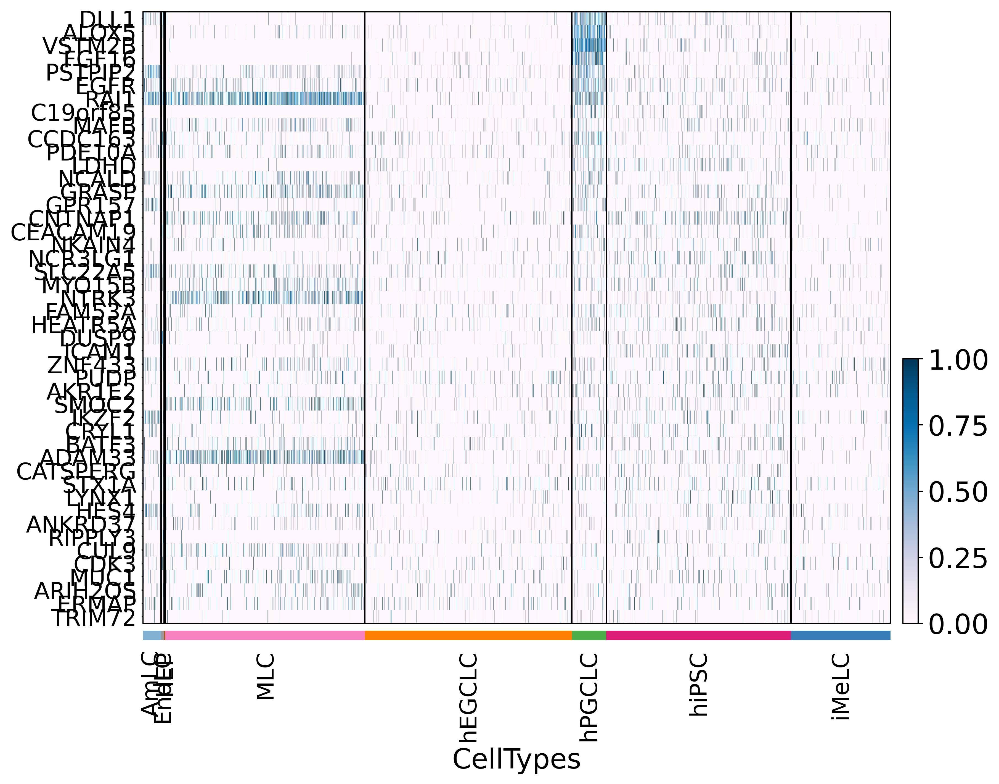

Cluster: 0 ------- Number of genes in cluster:  50


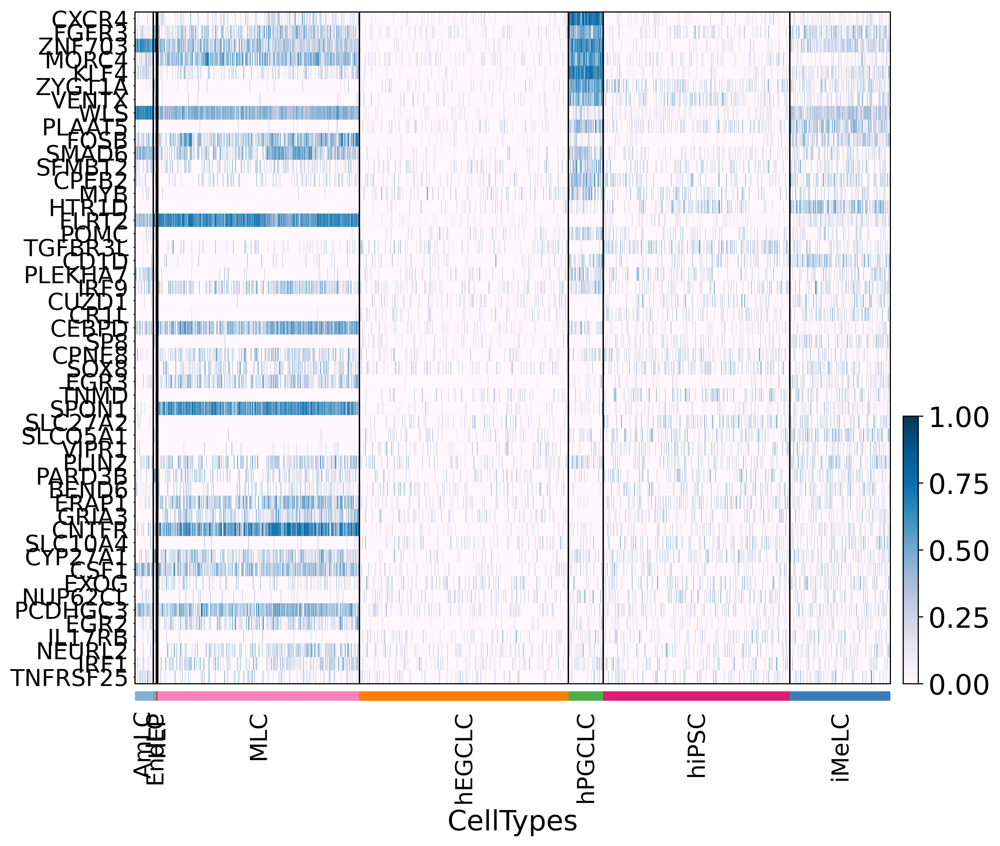

Cluster: 2 ------- Number of genes in cluster:  1499


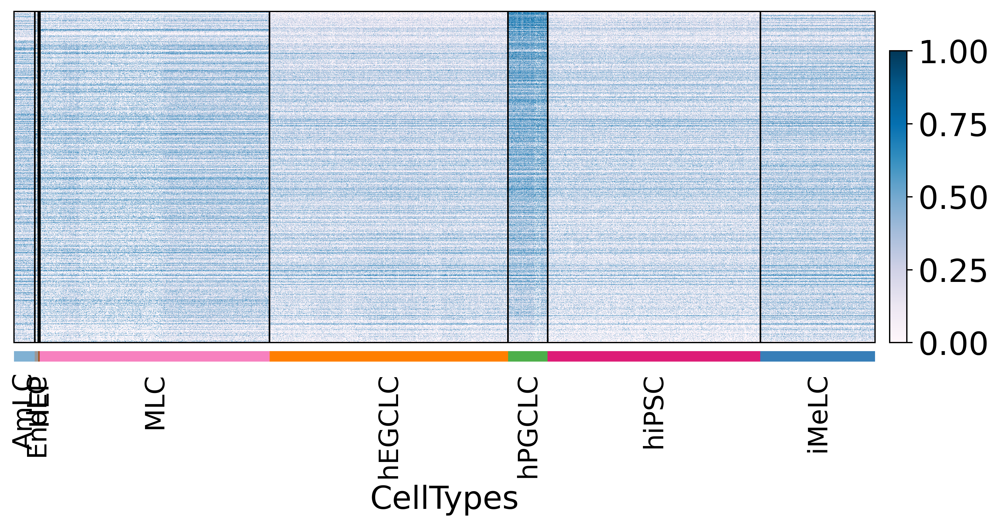

Cluster: 3 ------- Number of genes in cluster:  224


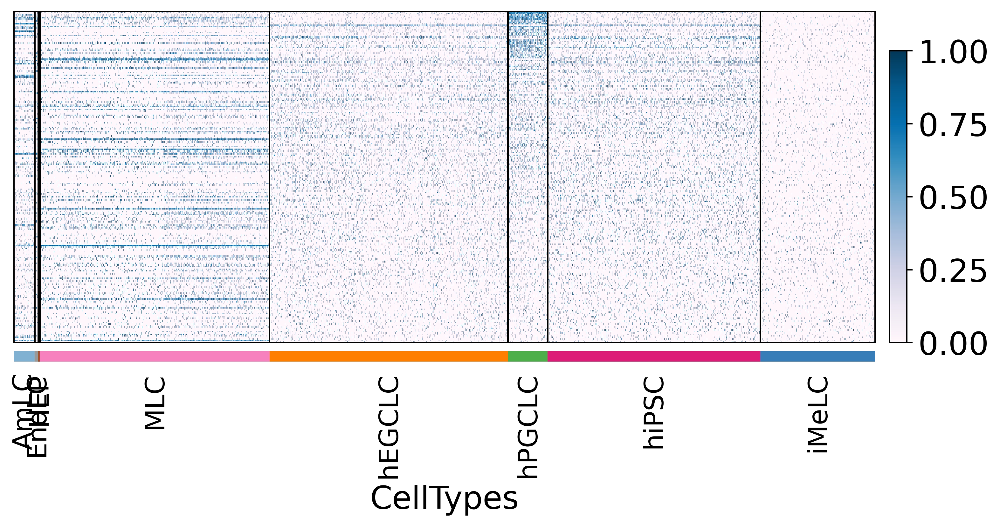

Cluster: 1 ------- Number of genes in cluster:  505


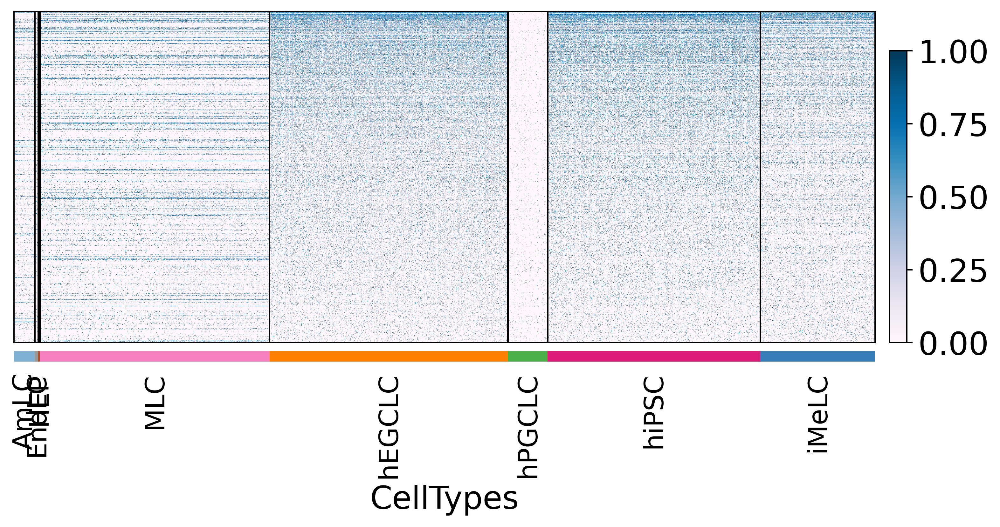

Cluster: 4 ------- Number of genes in cluster:  90


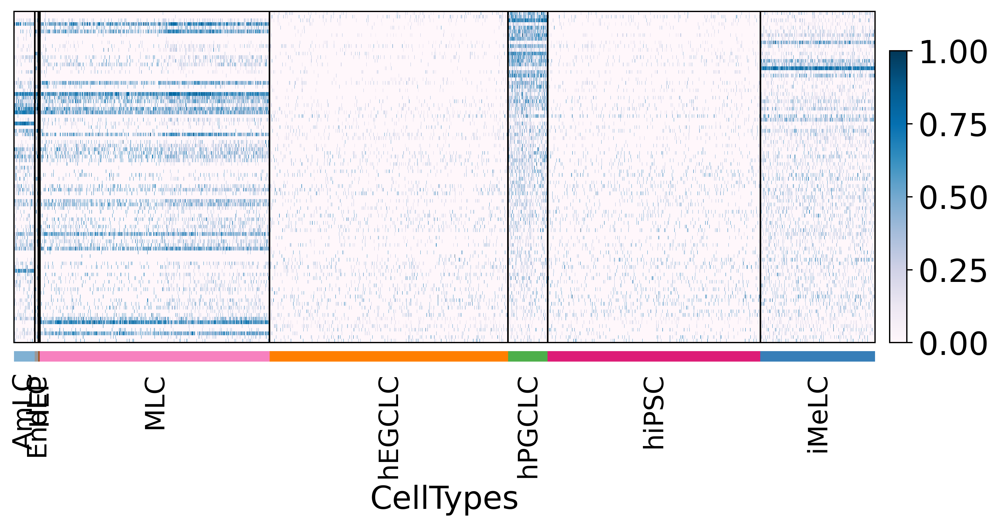

Cluster: 6 ------- Number of genes in cluster:  372


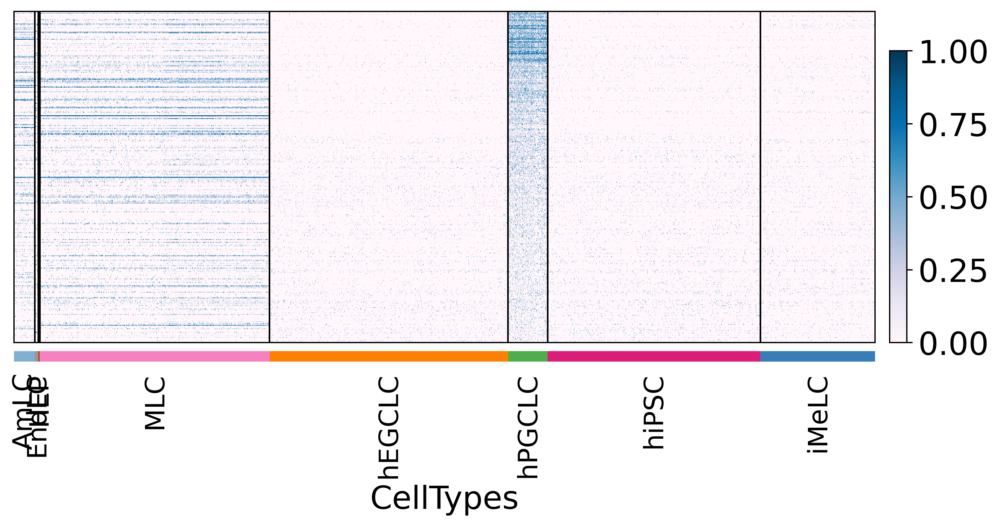

Cluster: 12 ------- Number of genes in cluster:  83


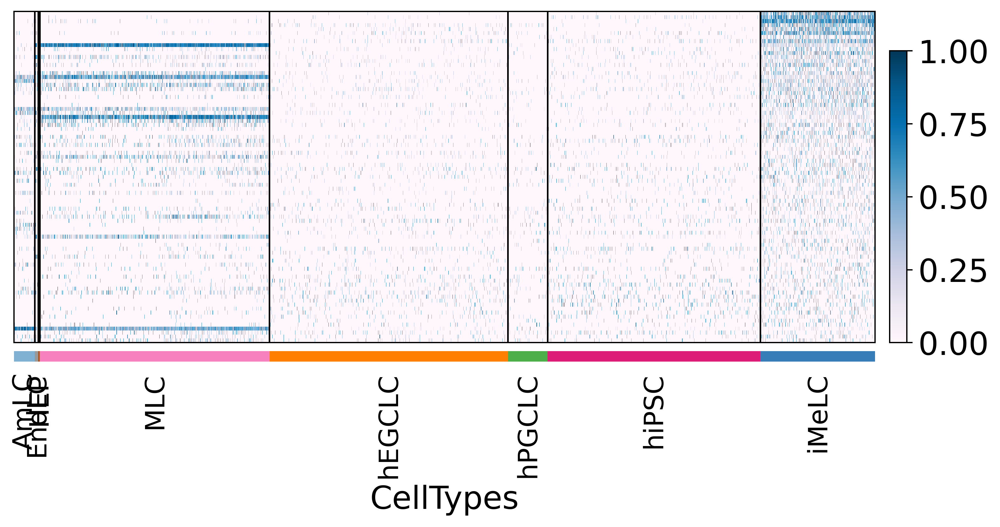

Cluster: 11 ------- Number of genes in cluster:  291


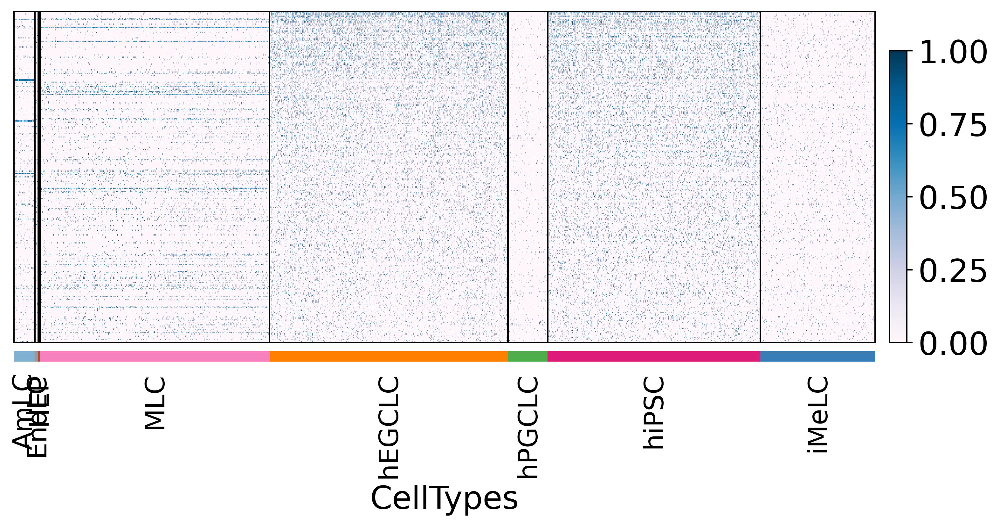

Cluster: 5 ------- Number of genes in cluster:  1384


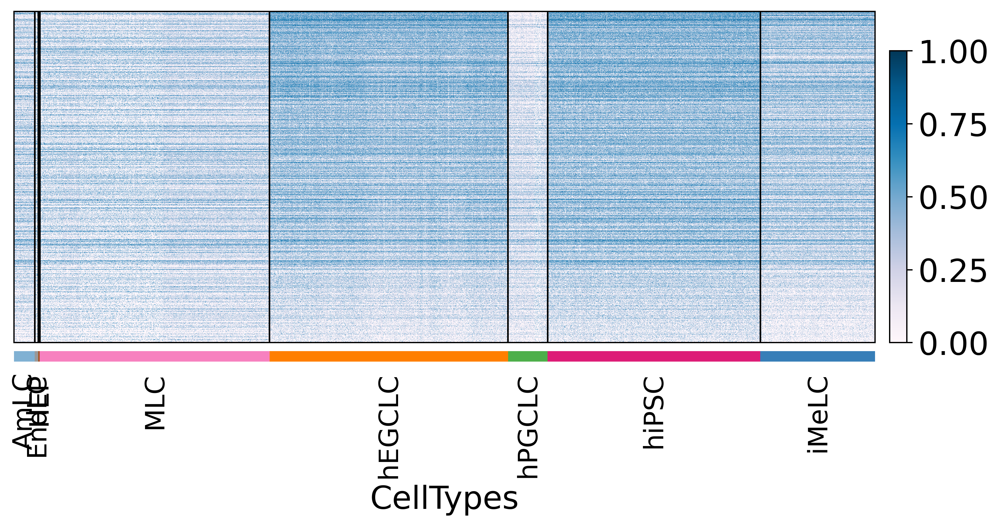

Cluster: 10 ------- Number of genes in cluster:  172


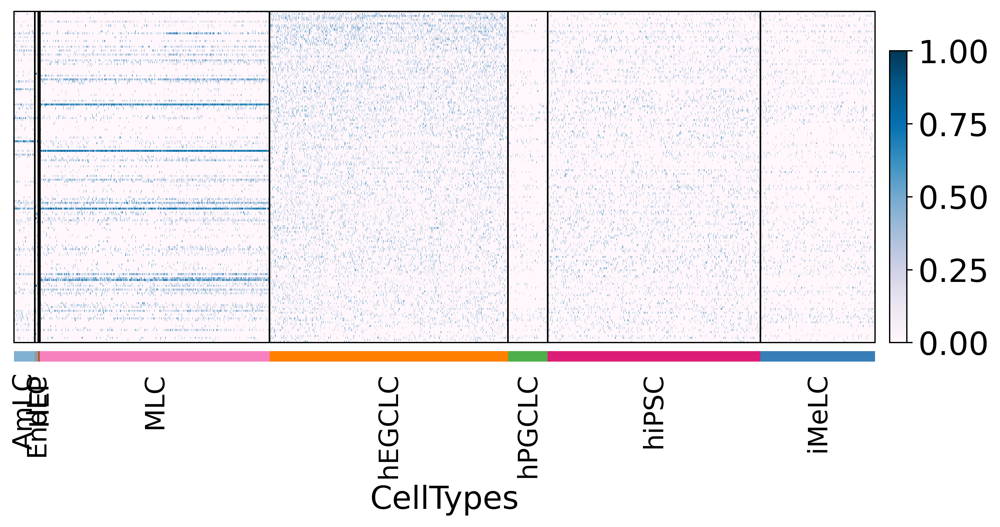

Cluster: 14 ------- Number of genes in cluster:  54


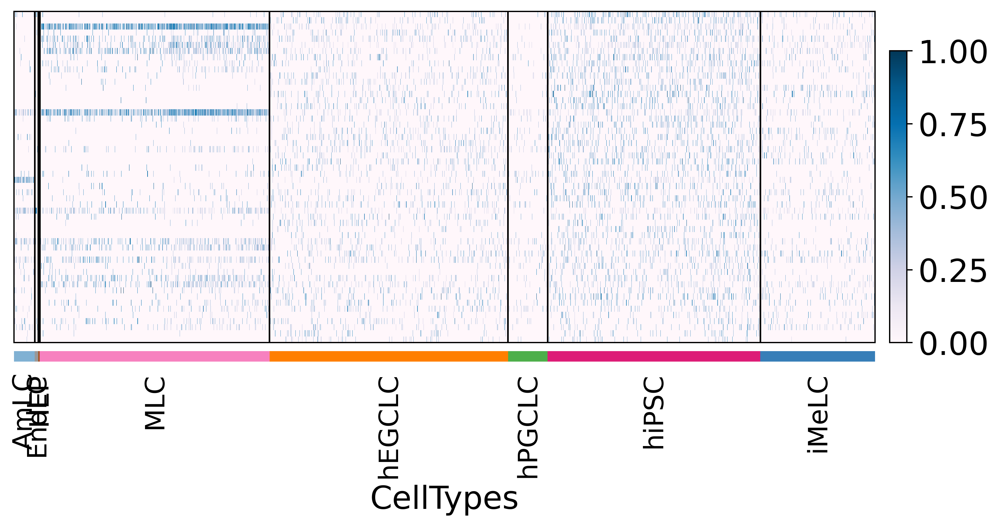

Cluster: 13 ------- Number of genes in cluster:  34


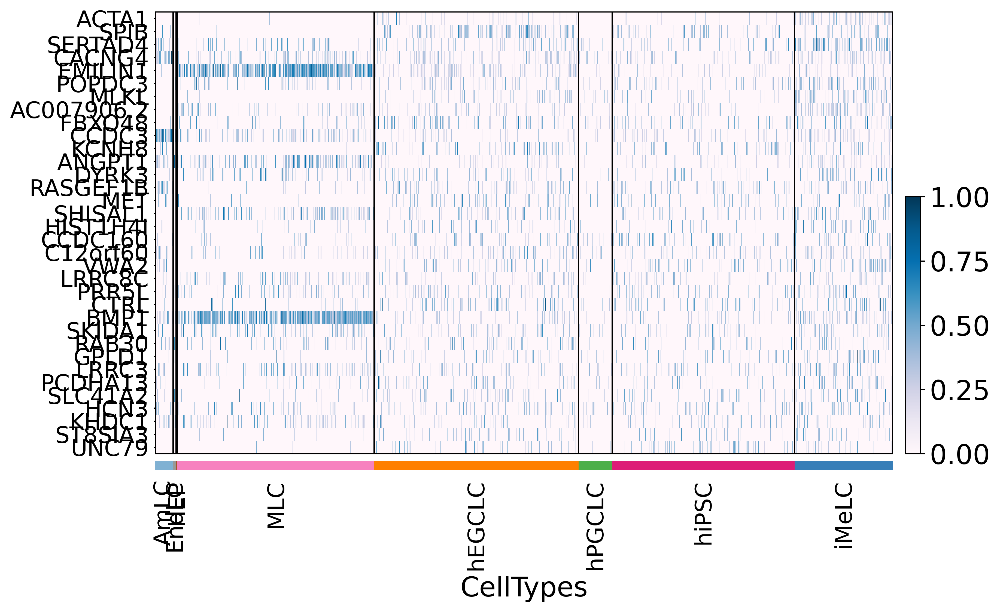

In [44]:
gene_clusters = {}
for i in res_filt.clusters.unique():
    gene_clusters[i] = res_filt[res_filt.clusters == i].index
    print("Cluster: " + str(i) + ' ------- Number of genes in cluster: ', len(gene_clusters[i]) )
    sc.pl.heatmap(adata, 
                  var_names = gene_clusters[i], 
              groupby = 'CellTypes', cmap = 'PuBu', swap_axes = True, 
               standard_scale='var',)
    #ax.title('Cluster: ' + str(i))
    plt.show()

In [45]:
gene_clusters[0]

Index(['CXCR4', 'FGFR3', 'ZNF703', 'MORC4', 'KLF4', 'ZYG11A', 'VENTX', 'WLS',
       'PLAAT5', 'FOSB', 'SMAD6', 'SFMBT2', 'CPEB2', 'MYB', 'HTR1D', 'FLRT2',
       'POMC', 'TGFBR3L', 'CD1D', 'PLEKHA7', 'IRF9', 'CUZD1', 'CR1L', 'CEBPD',
       'SP8', 'CPNE8', 'SOX8', 'EGR3', 'TNMD', 'SPON1', 'SLC27A2', 'SLCO5A1',
       'VIPR1', 'PLIN2', 'PARD3B', 'BEND6', 'ERAP1', 'GRIA3', 'CNTFR',
       'SLC10A4', 'CYP27A1', 'CSF1', 'EXOG', 'NUP62CL', 'PCDHGC3', 'EGR2',
       'IL17RB', 'NEURL2', 'IRF1', 'TNFRSF25'],
      dtype='object')

In [46]:
from scipy import sparse

In [47]:
adata_bulk_sub.X = sparse.csr_matrix(adata_bulk_sub.X)

In [48]:
adata_bulk_sub.obs.CellTypes.value_counts()

hEGCLC    3
hPGCLC    3
hiPSC     2
iMeLC     1
Name: CellTypes, dtype: int64

In [49]:
#??plot_box

In [50]:
def plot_box(
    adata,
    genes,
    meta,
    order=None,
    scaled = False,
    ncols=2,
    wspace=0.3,
    hspace=0.7,
    row_height=4,
    box_width=1.5,
    **kwargs
): 
    import matplotlib.pyplot as plt
    import pandas as pd
    import numpy as np
    import seaborn as sns
    from scipy import sparse
    from itertools import chain
    
    n_genes = len(genes)

    if n_genes % ncols > 0:
        n_rows = n_genes // ncols + 1
    else:
        n_rows = n_genes // ncols

    n_boxes = len(adata.obs[meta].unique())
    fig, ax = plt.subplots(
        n_rows,
        ncols,
        gridspec_kw=dict(wspace=wspace, hspace=hspace),
        figsize=((box_width * n_boxes) + wspace * (n_boxes - 1), row_height * n_rows),
    )
    
    try:
        ax = ax.flatten().T
        [p.set_axis_off() for p in ax[n_genes:]]
        
    except AttributeError:
        
        ax = [ax]

    
    
    gene_dict = {}
    
    if scaled:
        
        mat = pd.DataFrame(adata.layers['scaled'], index = adata.obs_names, columns = adata.var_names)
    
    else:
        
        mat = pd.DataFrame(adata.X.todense(), index = adata.obs_names, columns = adata.var_names)
    

    for gene in genes:

        y = np.array(mat[gene])
        #print(y)

        #keep = y != 0
        x = adata[:, gene].obs.loc[:, meta].tolist()
        #y = y[keep]
        
        gene_dict[gene] = {'x': x, 'y': y}
        
    all_y = []
    
    for gene in genes:
        all_y.append(gene_dict[gene]['y'])

    
    all_y = list(chain(*all_y))
        
    ymin = np.min(all_y) - 0.3
    ymax = np.max(all_y) + 0.3
    
        
    for gene, ax in zip(genes, ax):
        
        sns.boxplot(y=gene_dict[gene]['y'], x=gene_dict[gene]['x'], order=order, ax=ax, palette="Spectral", **kwargs)
        ax.set_title(gene)
        ax.set_xticklabels(ax.get_xticklabels(), rotation=90)
        ax.set_ylim(-0.5, ymax)

In [51]:
adata_bulk_sub[adata_bulk_sub.obs.CellTypes == 'hEGCLC', 'ID2'].X.todense()

matrix([[2.1153116],
        [2.4042046],
        [1.8111309]], dtype=float32)

In [52]:
adata[adata.obs.CellTypes == 'hEGCLC', 'ID2'].X.todense().sum()

1270.3586

In [53]:
adata[adata.obs.CellTypes == 'hEGCLC', 'ID2'].layers['raw'].todense()

matrix([[1.],
        [1.],
        [0.],
        ...,
        [0.],
        [0.],
        [0.]], dtype=float32)

## CLusters box plot

In [54]:
plot_box(adata_bulk_sub, genes = gene_clusters[0], meta = 'CellTypes', order = ['hiPSC', 'iMeLC', 'hPGCLC', 'hEGCLC'])

# Total heatmap

In [55]:
exp_mats = [pd.DataFrame(adata_bulk_sub[:,genes].X.todense(), index = adata_bulk_sub[:,genes].obs_names, columns = adata_bulk_sub[:,genes].var_names).T for genes in gene_clusters.values()]

In [56]:
complete_data = pd.concat(exp_mats, keys = gene_clusters.keys())

In [57]:
len(gene_clusters)

15

In [58]:
complete_data.to_csv('AggClust_Heatmap_data.csv')

In [59]:
color_palette_clusters = {i:j for i, j in zip(gene_clusters.keys(), sns.color_palette('rainbow', 15))}

In [60]:
complete_data = complete_data.reset_index().sort_values(by = 'level_0')
complete_data

,level_0,level_1,EG2_hEGCLC,EG31_hEGCLC,EG9_hEGCLC,2EB_hPGCLC,3EB_hPGCLC,5EB_hPGCLC,IEO_13_A_R_hiPSC,ht15_FIX_hiPSC,5IM_iMeLC
276,0,GRIA3,0.0,0.0,0.0,0.000000,0.000000,0.000000,2.047076,2.156489,2.110477
266,0,EGR3,0.0,0.0,0.0,2.368556,3.009080,2.316785,2.256900,1.214682,2.968673
265,0,SOX8,0.0,0.0,0.0,0.000000,0.000000,0.000000,2.280024,2.555344,2.355399
264,0,CPNE8,0.0,0.0,0.0,2.870382,2.798196,3.182135,2.330671,2.546102,1.946167
263,0,SP8,0.0,0.0,0.0,0.000000,0.000000,0.000000,1.814855,2.266716,2.872955
...,...,...,...,...,...,...,...,...,...,...,...
4939,14,CLIC6,0.0,0.0,0.0,0.000000,0.000000,0.000000,1.811541,2.128687,0.000000
4938,14,MCTP2,0.0,0.0,0.0,0.000000,0.000000,0.000000,2.139707,1.819353,0.000000
4937,14,SHISA6,0.0,0.0,0.0,0.000000,0.000000,0.000000,1.866443,2.100090,0.000000
4955,14,TMEM249,0.0,0.0,0.0,0.000000,0.000000,0.000000,1.982051,1.718393,0.000000


In [61]:
right_annotation = complete_data['level_0'].values.tolist()

In [62]:
complete_data

,level_0,level_1,EG2_hEGCLC,EG31_hEGCLC,EG9_hEGCLC,2EB_hPGCLC,3EB_hPGCLC,5EB_hPGCLC,IEO_13_A_R_hiPSC,ht15_FIX_hiPSC,5IM_iMeLC
276,0,GRIA3,0.0,0.0,0.0,0.000000,0.000000,0.000000,2.047076,2.156489,2.110477
266,0,EGR3,0.0,0.0,0.0,2.368556,3.009080,2.316785,2.256900,1.214682,2.968673
265,0,SOX8,0.0,0.0,0.0,0.000000,0.000000,0.000000,2.280024,2.555344,2.355399
264,0,CPNE8,0.0,0.0,0.0,2.870382,2.798196,3.182135,2.330671,2.546102,1.946167
263,0,SP8,0.0,0.0,0.0,0.000000,0.000000,0.000000,1.814855,2.266716,2.872955
...,...,...,...,...,...,...,...,...,...,...,...
4939,14,CLIC6,0.0,0.0,0.0,0.000000,0.000000,0.000000,1.811541,2.128687,0.000000
4938,14,MCTP2,0.0,0.0,0.0,0.000000,0.000000,0.000000,2.139707,1.819353,0.000000
4937,14,SHISA6,0.0,0.0,0.0,0.000000,0.000000,0.000000,1.866443,2.100090,0.000000
4955,14,TMEM249,0.0,0.0,0.0,0.000000,0.000000,0.000000,1.982051,1.718393,0.000000


In [63]:
color_palette_clusters = {i:j for i, j in zip(np.unique(complete_data['level_0'].astype('str')), sns.color_palette('rainbow', 15))}
color_palette_clusters

{'0': (0.37450980392156863, 0.19584546700716696, 0.9951469164070644),
 '1': (0.24901960784313726, 0.38410574917192586, 0.9806347704689777),
 '10': (0.12352941176470589, 0.5574894393428855, 0.9566044195004408),
 '11': (0.0019607843137254832, 0.7092813076058534, 0.9232891061054893),
 '12': (0.12745098039215685, 0.8336023852211194, 0.8810121942857845),
 '13': (0.2529411764705882, 0.9256376597815562, 0.8301840308155507),
 '14': (0.3784313725490196, 0.9818225628535369, 0.7712979623471807),
 '2': (0.503921568627451, 0.9999810273487268, 0.7049255469061472),
 '3': (0.6294117647058823, 0.9794097676013659, 0.631711006253251),
 '4': (0.7549019607843137, 0.9209055179449537, 0.5523649729605059),
 '5': (0.8803921568627451, 0.8267341748257635, 0.4676575928925868),
 '6': (1.0, 0.7005430375932911, 0.37841105004231035),
 '7': (1.0, 0.5472195469221114, 0.28549158627534216),
 '8': (1.0, 0.37270199199091436, 0.18980109344182594),
 '9': (1.0, 0.18374951781657037, 0.09226835946330202)}

In [64]:
complete_data.columns = ['Cluster', 'level_1', 'EG2_hEGCLC', 'EG31_hEGCLC', 'EG9_hEGCLC',
       '2EB_hPGCLC', '3EB_hPGCLC', '5EB_hPGCLC', 'IEO_13_A_R_hiPSC',
       'ht15_FIX_hiPSC', '5IM_iMeLC']

In [65]:
order = ["IEO_13_A_R_hiPSC", "ht15_FIX_hiPSC", "5IM_iMeLC", "2EB_hPGCLC", "3EB_hPGCLC", "5EB_hPGCLC",  "EG2_hEGCLC", "EG31_hEGCLC", "EG9_hEGCLC"]

In [66]:
col_colors = pd.Series([color_palette['hiPSC'], color_palette['hiPSC'], color_palette['iMeLC'], color_palette['hPGCLC'], color_palette['hPGCLC'], color_palette['hPGCLC'], 
                        color_palette['hEGCLC'], color_palette['hEGCLC'], color_palette['hEGCLC']], index = order).rename('CellType')

In [67]:
col_colors_dict = {i:j for i, j in zip(col_colors.index.astype('str'), col_colors.values)}

In [68]:
complete_data

,Cluster,level_1,EG2_hEGCLC,EG31_hEGCLC,EG9_hEGCLC,2EB_hPGCLC,3EB_hPGCLC,5EB_hPGCLC,IEO_13_A_R_hiPSC,ht15_FIX_hiPSC,5IM_iMeLC
276,0,GRIA3,0.0,0.0,0.0,0.000000,0.000000,0.000000,2.047076,2.156489,2.110477
266,0,EGR3,0.0,0.0,0.0,2.368556,3.009080,2.316785,2.256900,1.214682,2.968673
265,0,SOX8,0.0,0.0,0.0,0.000000,0.000000,0.000000,2.280024,2.555344,2.355399
264,0,CPNE8,0.0,0.0,0.0,2.870382,2.798196,3.182135,2.330671,2.546102,1.946167
263,0,SP8,0.0,0.0,0.0,0.000000,0.000000,0.000000,1.814855,2.266716,2.872955
...,...,...,...,...,...,...,...,...,...,...,...
4939,14,CLIC6,0.0,0.0,0.0,0.000000,0.000000,0.000000,1.811541,2.128687,0.000000
4938,14,MCTP2,0.0,0.0,0.0,0.000000,0.000000,0.000000,2.139707,1.819353,0.000000
4937,14,SHISA6,0.0,0.0,0.0,0.000000,0.000000,0.000000,1.866443,2.100090,0.000000
4955,14,TMEM249,0.0,0.0,0.0,0.000000,0.000000,0.000000,1.982051,1.718393,0.000000


In [69]:
from matplotlib.patches import Patch

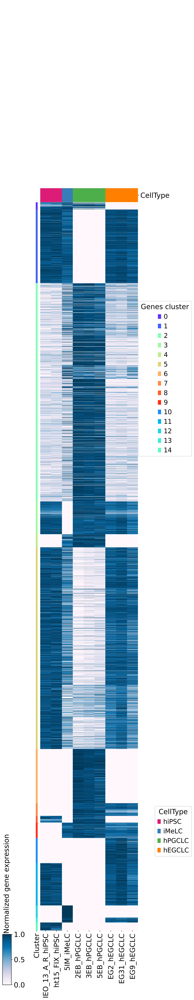

In [70]:
g = sns.clustermap(complete_data.drop(['Cluster', 'level_1'], axis = 1)[order], 
                   method='complete', metric='euclidean', cmap='PuBu', 
                   figsize=(7, 40), 
                   col_colors = col_colors,
                   row_colors = complete_data['Cluster'].astype('str').map(color_palette_clusters), 
                   standard_scale = 0,
                   row_cluster=False, col_cluster = False, colors_ratio=0.015, yticklabels=False)

x0, _y0, _w, _h = g.cbar_pos
g.ax_cbar.set_position([x0 - 0.01, 0.02, _w, 0.05])
g.ax_cbar.set_title('Normalized gene expression', rotation = 90)

g.ax_cbar.tick_params(axis='x', length=10)

for spine in g.ax_cbar.spines:
    #g.ax_cbar.spines[spine].set_color('crimson')
    g.ax_cbar.spines[spine].set_linewidth(1)
    
# Sort the unique cluster labels
cluster_labels_sorted = sorted(complete_data['Cluster'].astype('str').unique(), key=int)

# Sort the colors based on the sorted cluster labels
colors_sorted = [color_palette_clusters[name] for name in cluster_labels_sorted]

# Create legend handles using the sorted colors and cluster labels
handles = [Patch(facecolor=color) for color in colors_sorted]
legend1 = plt.legend(handles, cluster_labels_sorted, title='Genes cluster',
                     bbox_to_anchor=(1.1, 0.7), bbox_transform=plt.gcf().transFigure, loc='upper right')

# Sort the cell type labels and colors
cell_type_labels_sorted = ["IEO_13_A_R_hiPSC", "5IM_iMeLC", "5EB_hPGCLC",  "EG2_hEGCLC"]
cell_type_colors_sorted = [col_colors_dict[name] for name in cell_type_labels_sorted]

# Create legend handles using the sorted cell type colors and labels
handles = [Patch(facecolor=color) for color in cell_type_colors_sorted]
legend2 = plt.legend(handles, ['hiPSC', 'iMeLC', 'hPGCLC', 'hEGCLC'], title='CellType',
                     bbox_to_anchor=(1.1, 0.2), bbox_transform=plt.gcf().transFigure, loc='upper right')

# Add the legends to the plot
plt.gca().add_artist(legend2)
plt.gca().add_artist(legend1)

plt.savefig('complete_heatmap_genes_final.pdf', dpi=600)

# Run gene ontology enrichment for all clusters
Results are saved in a separate folder

In [71]:
import os
from subprocess import run

In [72]:
res_filt.clusters.unique()

array([ 9,  7,  8,  0,  2,  3,  1,  4,  6, 12, 11,  5, 10, 14, 13])

In [73]:
for i in res_filt.clusters.unique():
    dfToSave = res_filt[res_filt.clusters == i]
    folder = './tables/cluster_' + str(i)
    
    if not os.path.isdir(folder):
        os.makedirs(folder)
        
    dfToSave.to_excel(folder + '/genes_in_cluster_' + str(i) + '.xlsx')